In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling as pp

In [ ]:
#DataSet

df = pd.read_excel("COVID_case_report_final.xlsx", parse_dates=["Date"])
df.head()

,City,Total Laboratory-confirmed case,difference to the previous day,hospitalized,Deceased,Recover-A,current cases-B,Reported the last 7 days,Rhineland-Palatinate,+USAFD,<20 years,20-59 years-E,≥ 60 years,Date
0,Ahrweiler,5627,9,213.0,58,5071,498,36,27.6,27.6,57.1,24.7,16.3,2021-10-01
1,Altenkirchen,5749,4,458.0,105,5467,177,46,35.6,35.6,45.8,45.7,12.7,2021-10-01
2,Alzey-Worms,6064,13,365.0,127,5591,346,124,94.9,94.8,241.7,82.6,18.6,2021-10-01
3,Bad Dürkheim,5129,16,336.0,154,4588,387,63,47.4,47.4,64.8,59.1,20.5,2021-10-01
4,Bad Kreuznach,7047,19,183.0,143,6237,667,95,59.8,59.8,120.4,57.8,27.9,2021-10-01


Data Pre-processing

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16308 entries, 0 to 16307
Data columns (total 14 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   City                             16308 non-null  object        
 1   Total Laboratory-confirmed case  16308 non-null  int64         
 2   difference to the previous day   16308 non-null  int64         
 3   hospitalized                     16307 non-null  float64       
 4   Deceased                         16308 non-null  int64         
 5   Recover-A                        16308 non-null  int64         
 6   current cases-B                  16308 non-null  int64         
 7   Reported the last 7 days         16308 non-null  int64         
 8   Rhineland-Palatinate             16308 non-null  float64       
 9   +USAFD                           16308 non-null  float64       
 10  <20 years                        16308 non-null  object   

In [ ]:
#df.dropna(inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16308 entries, 0 to 16307
Data columns (total 14 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   City                             16308 non-null  object        
 1   Total Laboratory-confirmed case  16308 non-null  int64         
 2   difference to the previous day   16308 non-null  int64         
 3   hospitalized                     16307 non-null  float64       
 4   Deceased                         16308 non-null  int64         
 5   Recover-A                        16308 non-null  int64         
 6   current cases-B                  16308 non-null  int64         
 7   Reported the last 7 days         16308 non-null  int64         
 8   Rhineland-Palatinate             16308 non-null  float64       
 9   +USAFD                           16308 non-null  float64       
 10  <20 years                        16308 non-null  object   

In [ ]:
df["hospitalized"] = df["hospitalized"].apply(lambda x: x.replace(x, "None") if not isinstance(x, (float, int)) else x)
df["<20 years"] = df["<20 years"].apply(lambda x: x.replace(x, "None") if not isinstance(x, (float, int)) else x)
#df["<20 years"] = df["<20 years"].replace(r'^([A-Za-z]|[0-9]|_)+$', np.nan, regex = True).astype("float")
df["20-59 years-E"] = df["20-59 years-E"].apply(lambda x: x.replace(x, "None") if not isinstance(x, (float, int)) else x)
df["≥ 60 years"] = df["≥ 60 years"].apply(lambda x: x.replace(x, "None") if not isinstance(x, (float, int)) else x)

In [ ]:
df = df.replace("None", np.NaN).convert_dtypes()

In [ ]:
def creat_date_columns(data, date_column):

  temp_df = data.copy()
  temp_df["Day"] = temp_df[date_column].dt.day
  temp_df["month"] = temp_df[date_column].dt.month
  temp_df["year"] = temp_df[date_column].dt.year
  temp_df["dayofweek"] = temp_df[date_column].dt.dayofweek
  temp_df["quarter"] = temp_df[date_column].dt.quarter
  temp_df["dayofyear"] = temp_df[date_column].dt.dayofyear
  temp_df["weekday"] = temp_df[date_column].dt.weekday
  temp_df["week"] = temp_df[date_column].dt.week
  #df['Date'].dt.isocalendar()

  return temp_df

df = creat_date_columns(df, date_column = 'Date').set_index('Date')
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 16308 entries, 2021-10-01 to 2023-01-13
Data columns (total 21 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   City                             16308 non-null  string 
 1   Total Laboratory-confirmed case  16308 non-null  Int64  
 2   difference to the previous day   16308 non-null  Int64  
 3   hospitalized                     16307 non-null  Int64  
 4   Deceased                         16308 non-null  Int64  
 5   Recover-A                        16308 non-null  Int64  
 6   current cases-B                  16308 non-null  Int64  
 7   Reported the last 7 days         16308 non-null  Int64  
 8   Rhineland-Palatinate             16308 non-null  Float64
 9   +USAFD                           16308 non-null  Float64
 10  <20 years                        16307 non-null  Float64
 11  20-59 years-E                    16307 non-null  Float64
 12  ≥

<ipython-input-8-31b05050c79d>:11: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  temp_df["week"] = temp_df[date_column].dt.week


Pandas Profiling

In [ ]:
import pandas_profiling as pp

pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 16308 entries, 2021-10-01 to 2023-01-13
Data columns (total 21 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   City                             16308 non-null  string 
 1   Total Laboratory-confirmed case  16308 non-null  Int64  
 2   difference to the previous day   16308 non-null  Int64  
 3   hospitalized                     16307 non-null  Int64  
 4   Deceased                         16308 non-null  Int64  
 5   Recover-A                        16308 non-null  Int64  
 6   current cases-B                  16308 non-null  Int64  
 7   Reported the last 7 days         16308 non-null  Int64  
 8   Rhineland-Palatinate             16308 non-null  Float64
 9   +USAFD                           16308 non-null  Float64
 10  <20 years                        16307 non-null  Float64
 11  20-59 years-E                    16307 non-null  Float64
 12  ≥

In [ ]:
df.columns

Index(['City', 'Total Laboratory-confirmed case',
       'difference to the previous day', 'hospitalized', 'Deceased',
       'Recover-A', 'current cases-B', 'Reported the last 7 days',
       'Rhineland-Palatinate', '+USAFD', '<20 years', '20-59 years-E',
       '≥ 60 years', 'Day', 'month', 'year', 'dayofweek', 'quarter',
       'dayofyear', 'weekday', 'week'],
      dtype='object')

In [ ]:
# fill null values -> backward fill

#df = df.fillna('bfill', axis=1)
# for col in df.select_dtypes(include = ['O']).columns[1:]:
#   pd.to_numeric(df[col], errors="ignore")

<Axes: ylabel='City'>

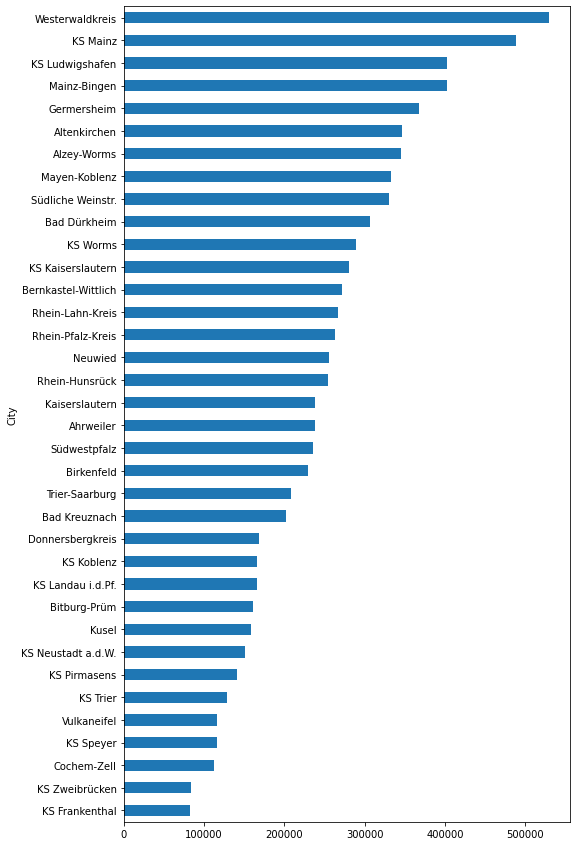

In [ ]:
df.groupby('City')["hospitalized"].agg("sum").sort_values(ascending = True).plot(kind='barh', figsize = (8,15))

In [ ]:
df.head()

,City,Total Laboratory-confirmed case,difference to the previous day,hospitalized,Deceased,Recover-A,current cases-B,Reported the last 7 days,Rhineland-Palatinate,+USAFD,...,20-59 years-E,≥ 60 years,Day,month,year,dayofweek,quarter,dayofyear,weekday,week
Date,,,,,,,,,,,,,,,,,,,,,
2021-10-01,Ahrweiler,5627,9,213,58,5071,498,36,27.6,27.6,...,24.7,16.3,1,10,2021,4,4,274,4,39
2021-10-01,Altenkirchen,5749,4,458,105,5467,177,46,35.6,35.6,...,45.7,12.7,1,10,2021,4,4,274,4,39
2021-10-01,Alzey-Worms,6064,13,365,127,5591,346,124,94.9,94.8,...,82.6,18.6,1,10,2021,4,4,274,4,39
2021-10-01,Bad Dürkheim,5129,16,336,154,4588,387,63,47.4,47.4,...,59.1,20.5,1,10,2021,4,4,274,4,39
2021-10-01,Bad Kreuznach,7047,19,183,143,6237,667,95,59.8,59.8,...,57.8,27.9,1,10,2021,4,4,274,4,39


<Axes: xlabel='Date'>

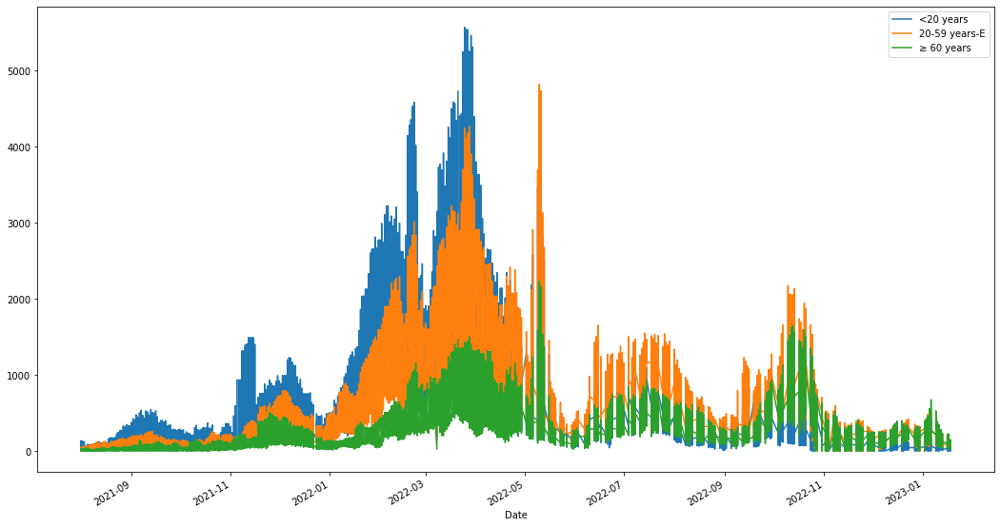

In [ ]:
df[['<20 years', '20-59 years-E', '≥ 60 years']].plot(figsize=(18,10))

Develop LSTM Model For Covid-19 Time Series Forecasting

<Axes: xlabel='Date'>

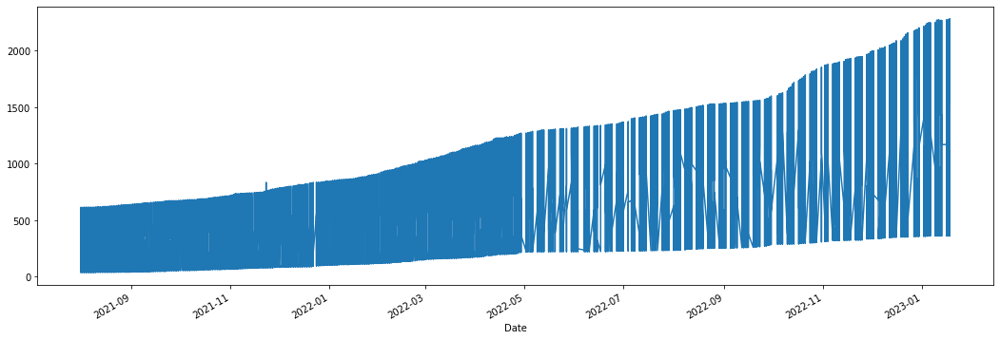

In [ ]:
from pandas.core import resample

data = df['hospitalized']
data.plot(kind="line", figsize=(18, 6))

In [ ]:
df.dropna(inplace=True)

LSTM - Lasso

In [ ]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split

In [ ]:
m = Lasso()

In [ ]:
df.columns

Index(['City', 'Total Laboratory-confirmed case',
       'difference to the previous day', 'hospitalized', 'Deceased',
       'Recover-A', 'current cases-B', 'Reported the last 7 days',
       'Rhineland-Palatinate', '+USAFD', '<20 years', '20-59 years-E',
       '≥ 60 years', 'Day', 'month', 'year', 'dayofweek', 'quarter',
       'dayofyear', 'weekday', 'week'],
      dtype='object')

In [ ]:
city_map = {v:i for i,v in enumerate(df["City"].unique())}
df['City'] = df['City'].map(city_map)

In [ ]:
target = 'hospitalized'
df = df.interpolate('bfill')
X = df.drop(target, axis = 1)
y = df[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.01, random_state=42)

NameError: ignored

In [ ]:
m.fit(X_train, y_train)
y_pred = m.predict(X_test)

/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.850e+08, tolerance: 2.023e+05
  model = cd_fast.enet_coordinate_descent(


In [ ]:
X_test['predicted'] = y_pred
X_test = X_test.merge(y_test, left_index=True, right_index=True)

<Axes: xlabel='Date'>

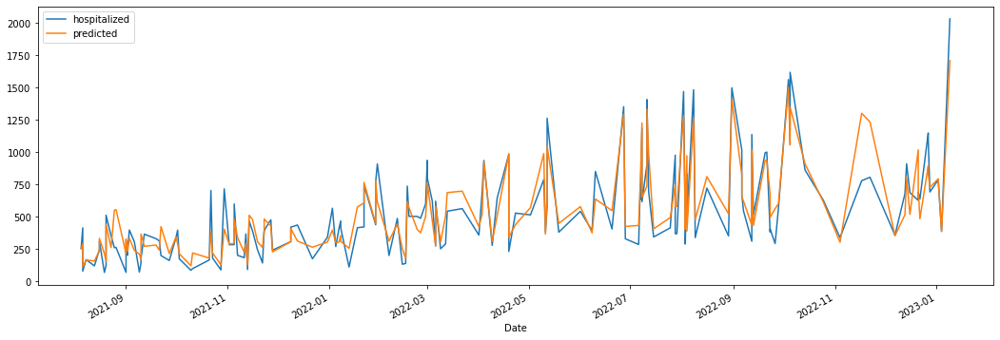

In [ ]:
X_test[[target, 'predicted']].plot(figsize=(18, 6))

In [ ]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

print("R2 score: ", r2_score(y_pred, y_test))
print("mean_absolute_error: ", mean_absolute_error(y_pred, y_test))
print("mean_squared_error: ", mean_squared_error(y_pred, y_test))

R2 score:  0.7996029325668534
mean_absolute_error:  106.45392021948895
mean_squared_error:  20000.43213132808



Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestRegressor

In [ ]:
rf = RandomForestRegressor(n_estimators=100, random_state=42)

In [ ]:
target1 = 'hospitalized'
df = df.interpolate('bfill')
X1 = df.drop(target, axis = 1)
y1 = df[target]

X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.03, random_state=42)


In [ ]:
rf.fit(X_train1, y_train1)
y_pred1 = rf.predict(X_test1)


In [ ]:
X_test1['predicted1'] = y_pred1
X_test1 = X_test1.merge(y_test1, left_index=True, right_index=True)

<Axes: xlabel='Date'>

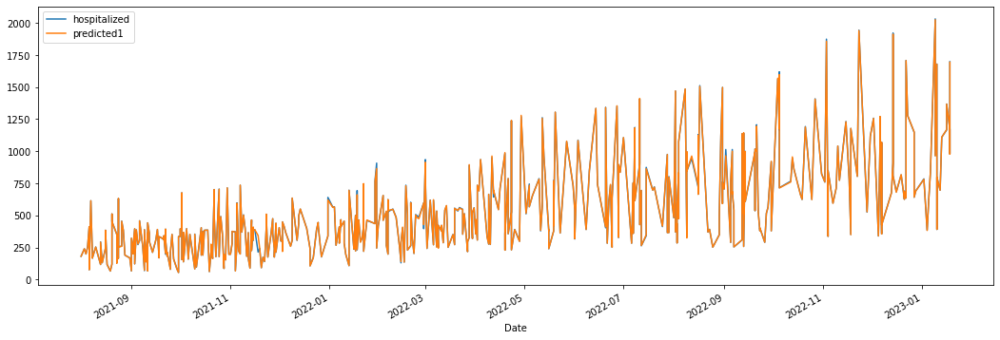

In [ ]:
X_test1[[target1, 'predicted1']].plot(figsize=(18, 6))

In [ ]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

print("R2 score: ", r2_score(y_pred1, y_test1))
print("mean_absolute_error: ", mean_absolute_error(y_pred1, y_test1))
print("mean_squared_error: ", mean_squared_error(y_pred1, y_test1))

R2 score:  0.9994920088050434
mean_absolute_error:  2.6719591836734695
mean_squared_error:  63.61984571428573
